In [1]:
#Heavy Decoder 
#BottleNeck: 10

In [2]:
#Disable Warning
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import warnings
warnings.filterwarnings("ignore")

In [3]:
FILE1 = 'SB-001_normalized_AM.csv'
FILE2 = 'SB-001_normalized_PM.csv'
NO_OF_COLUMNS = 24

In [4]:
#pip install tf2onnx
import tensorflow as tf
from tensorflow import keras
import seaborn as sns
import matplotlib.pyplot as plt
plt.ioff()
import cv2
import IPython
from tqdm import tqdm
import time
import os
import pickle
import pandas as pd
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
warnings.filterwarnings('ignore', message=r'.*Consider either turning off auto-sharding.*')

In [5]:
run_summary = []

In [6]:
def generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers):

    print(encoder_dense_layers, bottle_neck, decoder_dense_layers)
    # Load Data
    df_am = pd.read_csv(FILE1)
    df_pm = pd.read_csv(FILE2)
    combined_df = pd.concat([df_am, df_pm])

    columns_needed = ['y_am_pef', 'tempin', 'humidin', 'pm25in', 'co2in', 'tempdiffin', 'humidiffin', 'pm25diffin',
                      'pm10', 'pm25', 'o3', 'no2', 'co', 'so2', 'temp', 'windsd', 'humid', 'varp', 'dewpt', 'airp',
                      'seap', 'solrhr', 'solramnt', 'grdt', 'class']
    combined_df = combined_df.filter(columns_needed)
    df = combined_df.sample(frac=1, random_state=42).reset_index(drop=True)

    # Drop NaN
    df = df.dropna()

    # Minotity Split
    class_counts = df['class'].value_counts()
    minority_class = df[df['class'] == 0]
    majority_class = df[df['class'] == 1]

    # Removing class column from minority before augmentation
    X = minority_class.drop('class', axis=1)
    y = minority_class['class']

    # Saving minority as X_train
    X_train = X

    # Define the Input shape
    INPUT_SHAPE = X_train.shape[1]
    FILE_NAME = f"L{INPUT_SHAPE}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"
    print("\n" + FILE_NAME + "\n")
    
    def build_autoencoder(input_shape, **kwargs):

        # Autoencoder model construction cod

      """
      Build an autoencoder model with the given configuration.

      Args:
          input_shape (int): The shape of the input data.
          **kwargs: Additional keyword arguments for configuring the autoencoder.

      Keyword Args:
          encoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the encoder.
                                      Default: []
          bottle_neck (int): The number of units in the bottleneck layer. Default: input_shape // 2
          decoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the decoder.
                                      Default: []
          decoder_activation (str): The activation function for the decoder output layer. Default: 'sigmoid'

      Returns:
          tuple: A tuple containing the autoencoder, encoder, and decoder models.

      Example:
          INPUT_SHAPE = 27
          encoder_dense_layers = [20, 18]  # Specify the number of units for each dense layer in the encoder
          bottle_neck = 16
          decoder_dense_layers = [18, 20]  # Specify the number of units for each dense layer in the decoder

          autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                            bottle_neck=bottle_neck, decoder_dense_layers=decoder_dense_layers)
          encoder.summary()
          decoder.summary()
          autoencoder.summary()
      """

      # Default parameter values
      encoder_dense_layers = kwargs.get('encoder_dense_layers', [])
      bottle_neck = kwargs.get('bottle_neck', input_shape // 2)
      decoder_dense_layers = kwargs.get('decoder_dense_layers', [])
      decoder_activation = kwargs.get('decoder_activation', 'sigmoid')

      # Autoencoder Model
      encoder_input = keras.Input(shape=(input_shape,), name="encoder")
      x = keras.layers.Flatten()(encoder_input)

      # Encoder Dense Layers
      for units in encoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      encoder_output = keras.layers.Dense(bottle_neck, activation="relu")(x)
      encoder = keras.Model(encoder_input, encoder_output, name="encoder")

      # Decoder Model
      decoder_input = keras.Input(shape=(bottle_neck,), name="decoder")
      x = decoder_input

      # Decoder Dense Layers
      for units in decoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      decoder_output = keras.layers.Dense(input_shape, activation=decoder_activation)(x)
      decoder = keras.Model(decoder_input, decoder_output, name="decoder")

      # Autoencoder Model
      autoencoder_input = keras.Input(shape=(input_shape,), name="input")
      encoded = encoder(autoencoder_input)
      decoded = decoder(encoded)
      autoencoder = keras.Model(autoencoder_input, decoded, name="autoencoder")

      return autoencoder, encoder, decoder

    autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                      bottle_neck=bottle_neck,
                                                      decoder_dense_layers=decoder_dense_layers)
    opt = keras.optimizers.Adam(learning_rate=0.001)
    autoencoder.compile(opt, loss="mse")

    print("Training model:", FILE_NAME)
    history = autoencoder.fit(X_train, X_train, epochs=200, batch_size=16, validation_split=0.25, verbose=0)
    print("Training Complete:")
    
    # Extract the loss values
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # Print the last epoch's loss values
    last_epoch_loss = loss[-1]
    last_epoch_val_loss = val_loss[-1]
    print("Last epoch loss:", last_epoch_loss)
    print("Last epoch validation loss:", last_epoch_val_loss)

    # Saving history
    with open(FILE_NAME + '_history.pickle', 'wb') as file:
        pickle.dump(history.history, file)

    # Visualize losses *(MSE)
    train_loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(train_loss) + 1)
    plt.plot(epochs, train_loss, 'b', label='Training Loss')
    plt.plot(epochs, val_loss, 'r', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig(FILE_NAME + 'Loss.png')
    #plt.show()

    # Generate synthetic data
    num_samples = len(X_train)
    input_data = np.random.normal(size=(num_samples, INPUT_SHAPE))
    generated_data = autoencoder.predict(input_data)
    reshaped_data = generated_data.reshape(num_samples, -1)
    df_generated = pd.DataFrame(reshaped_data, columns=X_train.columns)

    # Plot correlation matrices
    corr_matrix1 = X_train.corr()
    corr_matrix2 = df_generated.corr()

    fig, axes = plt.subplots(1, 2, figsize=(18, 10))
    sns.heatmap(corr_matrix1, annot=True, cmap='coolwarm', ax=axes[0])
    axes[0].set_title('Heatmap 1')

    sns.heatmap(corr_matrix2, annot=True, cmap='coolwarm', ax=axes[1])
    axes[1].set_title('Heatmap 2')

    plt.tight_layout()
    plt.savefig(FILE_NAME + 'HeatMaps')
    #plt.show()

    # Calculate mean and standard deviation of original and synthetic datasets
    common_columns = set(X_train.columns) & set(df_generated.columns)
    results = {}

    for column in common_columns:
        mean_df1 = X_train[column].mean()
        std_df1 = X_train[column].std()
        mean_df2 = df_generated[column].mean()
        std_df2 = df_generated[column].std()

        results[column] = {'Mean_df1': mean_df1, 'Std_df1': std_df1,
                           'Mean_df2': mean_df2, 'Std_df2': std_df2}

    comparison_df = pd.DataFrame(results)
    comparison_df.to_csv(FILE_NAME + 'mean_std.csv', index=True)

    # Plot scatter plots
    new_index = pd.RangeIndex(start=0, stop=57, step=1)
    X_train = X_train.set_index(new_index)
    common_columns = set(X_train.columns) & set(df_generated.columns)

    for column in common_columns:
        plt.scatter(X_train.index, X_train[column], color='red', label='X_train')
        plt.scatter(df_generated.index, df_generated[column], color='blue', label='df_generated')

        plt.title(f"Scatter Plot: {column}")
        plt.xlabel("Index")
        plt.ylabel(column)

        plt.legend()
        plt.savefig(FILE_NAME + "_" + column)
        #plt.show()


    # Add back the class label
    X_train['class'] = 0.0
    df_generated['class'] = 0.0
    X_train.to_csv(FILE_NAME + 'Original_minority_data.csv', index=False)
    df_generated.to_csv(FILE_NAME + 'Synthetic_minority_data.csv', index=False)

    # Generate quality report and display it
    real_data = FILE_NAME + 'Original_minority_data.csv'
    synth_data = FILE_NAME + 'Synthetic_minority_data.csv'

    # report = QualityReport(data_source=synth_data, ref_data=real_data)
    # report.run()

    # print(report.peek())
    #run_summary.append([FILE_NAME, report.peek()['raw_score'], report.peek()['grade']])
    run_summary.append([FILE_NAME, last_epoch_loss, last_epoch_val_loss])

    print("Reports Saved")
    #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))
    return None

In [7]:
# Example usage
def runner(encoder_dense_layers, bottle_neck, decoder_dense_layers):
  #encoder_dense_layers = [10, 8]
  #bottle_neck = 5
  #decoder_dense_layers = [8, 10]
  #FILE_NAME = f"24_{'_'.join(map(str, encoder_dense_layers))}_{bottle_neck}_"
  FILE_NAME = f"L{NO_OF_COLUMNS}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"   
  report = generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers)
  #print(type(report))
  # Save the report object to a file
  # with open(FILE_NAME + 'quality_report.pickle', 'wb') as file:
  #     pickle.dump(report, file)

  #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))

In [8]:
# here goes nothin

In [9]:
encoder_dense_layers_trial = [[10, 8], [12, 10], [14, 12], [16, 14], [18, 16], [20, 18],[22, 20]]
decoder_dense_layers_trial = [[6, 8, 10, 12], [8, 10, 12, 14], [10, 12, 14, 16], [12, 14, 16, 18], [14, 16, 18, 20], 
                              [16, 18, 20, 22], [18, 20, 22, 24]]
bottle_neck_trial = [10]

In [10]:
total_iterations = len(bottle_neck_trial) * len(encoder_dense_layers_trial) * len(decoder_dense_layers_trial)
print("Total Model in Pipeline:",total_iterations)

# Print total models
for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)

Total Model in Pipeline: 49
[10, 8] 10 [6, 8, 10, 12]
[10, 8] 10 [8, 10, 12, 14]
[10, 8] 10 [10, 12, 14, 16]
[10, 8] 10 [12, 14, 16, 18]
[10, 8] 10 [14, 16, 18, 20]
[10, 8] 10 [16, 18, 20, 22]
[10, 8] 10 [18, 20, 22, 24]
[12, 10] 10 [6, 8, 10, 12]
[12, 10] 10 [8, 10, 12, 14]
[12, 10] 10 [10, 12, 14, 16]
[12, 10] 10 [12, 14, 16, 18]
[12, 10] 10 [14, 16, 18, 20]
[12, 10] 10 [16, 18, 20, 22]
[12, 10] 10 [18, 20, 22, 24]
[14, 12] 10 [6, 8, 10, 12]
[14, 12] 10 [8, 10, 12, 14]
[14, 12] 10 [10, 12, 14, 16]
[14, 12] 10 [12, 14, 16, 18]
[14, 12] 10 [14, 16, 18, 20]
[14, 12] 10 [16, 18, 20, 22]
[14, 12] 10 [18, 20, 22, 24]
[16, 14] 10 [6, 8, 10, 12]
[16, 14] 10 [8, 10, 12, 14]
[16, 14] 10 [10, 12, 14, 16]
[16, 14] 10 [12, 14, 16, 18]
[16, 14] 10 [14, 16, 18, 20]
[16, 14] 10 [16, 18, 20, 22]
[16, 14] 10 [18, 20, 22, 24]
[18, 16] 10 [6, 8, 10, 12]
[18, 16] 10 [8, 10, 12, 14]
[18, 16] 10 [10, 12, 14, 16]
[18, 16] 10 [12, 14, 16, 18]
[18, 16] 10 [14, 16, 18, 20]
[18, 16] 10 [16, 18, 20, 22]
[18, 16]

[10, 8] 10 [6, 8, 10, 12]
[10, 8] 10 [6, 8, 10, 12]

L24_E10_8_B10_D6_8_10_12

Training model: L24_E10_8_B10_D6_8_10_12
Training Complete:
Last epoch loss: 0.01617749035358429
Last epoch validation loss: 0.02461046352982521
Reports Saved
[10, 8] 10 [8, 10, 12, 14]
[10, 8] 10 [8, 10, 12, 14]

L24_E10_8_B10_D8_10_12_14

Training model: L24_E10_8_B10_D8_10_12_14
Training Complete:
Last epoch loss: 0.011990569531917572
Last epoch validation loss: 0.018966563045978546
Reports Saved
[10, 8] 10 [10, 12, 14, 16]
[10, 8] 10 [10, 12, 14, 16]

L24_E10_8_B10_D10_12_14_16

Training model: L24_E10_8_B10_D10_12_14_16
Training Complete:
Last epoch loss: 0.011335117742419243
Last epoch validation loss: 0.01934669353067875
Reports Saved
[10, 8] 10 [12, 14, 16, 18]
[10, 8] 10 [12, 14, 16, 18]

L24_E10_8_B10_D12_14_16_18

Training model: L24_E10_8_B10_D12_14_16_18
Training Complete:
Last epoch loss: 0.011492903344333172
Last epoch validation loss: 0.01852264069020748
Reports Saved
[10, 8] 10 [14, 16, 18, 

Reports Saved
[12, 10] 10 [16, 18, 20, 22]
[12, 10] 10 [16, 18, 20, 22]

L24_E12_10_B10_D16_18_20_22

Training model: L24_E12_10_B10_D16_18_20_22
Training Complete:
Last epoch loss: 0.01257435791194439
Last epoch validation loss: 0.020960185676813126
Reports Saved
[12, 10] 10 [18, 20, 22, 24]
[12, 10] 10 [18, 20, 22, 24]

L24_E12_10_B10_D18_20_22_24

Training model: L24_E12_10_B10_D18_20_22_24
Training Complete:
Last epoch loss: 0.01757943443953991
Last epoch validation loss: 0.026171820238232613
Reports Saved
[14, 12] 10 [6, 8, 10, 12]
[14, 12] 10 [6, 8, 10, 12]

L24_E14_12_B10_D6_8_10_12

Training model: L24_E14_12_B10_D6_8_10_12
Training Complete:
Last epoch loss: 0.014620586298406124
Last epoch validation loss: 0.021581241860985756
Reports Saved
[14, 12] 10 [8, 10, 12, 14]
[14, 12] 10 [8, 10, 12, 14]

L24_E14_12_B10_D8_10_12_14

Training model: L24_E14_12_B10_D8_10_12_14
Training Complete:
Last epoch loss: 0.01281112153083086
Last epoch validation loss: 0.01952347718179226
Reports 

Reports Saved
[16, 14] 10 [6, 8, 10, 12]
[16, 14] 10 [6, 8, 10, 12]

L24_E16_14_B10_D6_8_10_12

Training model: L24_E16_14_B10_D6_8_10_12
Training Complete:
Last epoch loss: 0.01993395946919918
Last epoch validation loss: 0.02918754331767559
Reports Saved
[16, 14] 10 [8, 10, 12, 14]
[16, 14] 10 [8, 10, 12, 14]

L24_E16_14_B10_D8_10_12_14

Training model: L24_E16_14_B10_D8_10_12_14
Training Complete:
Last epoch loss: 0.013325458392500877
Last epoch validation loss: 0.01986823044717312
Reports Saved
[16, 14] 10 [10, 12, 14, 16]
[16, 14] 10 [10, 12, 14, 16]

L24_E16_14_B10_D10_12_14_16

Training model: L24_E16_14_B10_D10_12_14_16
Training Complete:
Last epoch loss: 0.008458378724753857
Last epoch validation loss: 0.016088435426354408
Reports Saved
[16, 14] 10 [12, 14, 16, 18]
[16, 14] 10 [12, 14, 16, 18]

L24_E16_14_B10_D12_14_16_18

Training model: L24_E16_14_B10_D12_14_16_18
Training Complete:
Last epoch loss: 0.014076923951506615
Last epoch validation loss: 0.024699261412024498
Reports

Reports Saved
[18, 16] 10 [10, 12, 14, 16]
[18, 16] 10 [10, 12, 14, 16]

L24_E18_16_B10_D10_12_14_16

Training model: L24_E18_16_B10_D10_12_14_16
Training Complete:
Last epoch loss: 0.01648060791194439
Last epoch validation loss: 0.024379078298807144
Reports Saved
[18, 16] 10 [12, 14, 16, 18]
[18, 16] 10 [12, 14, 16, 18]

L24_E18_16_B10_D12_14_16_18

Training model: L24_E18_16_B10_D12_14_16_18
Training Complete:
Last epoch loss: 0.012067924253642559
Last epoch validation loss: 0.018092360347509384
Reports Saved
[18, 16] 10 [14, 16, 18, 20]
[18, 16] 10 [14, 16, 18, 20]

L24_E18_16_B10_D14_16_18_20

Training model: L24_E18_16_B10_D14_16_18_20
Training Complete:
Last epoch loss: 0.00943741761147976
Last epoch validation loss: 0.01832187920808792
Reports Saved
[18, 16] 10 [16, 18, 20, 22]
[18, 16] 10 [16, 18, 20, 22]

L24_E18_16_B10_D16_18_20_22

Training model: L24_E18_16_B10_D16_18_20_22
Training Complete:
Last epoch loss: 0.010487803258001804
Last epoch validation loss: 0.01960589177906

Reports Saved
[20, 18] 10 [14, 16, 18, 20]
[20, 18] 10 [14, 16, 18, 20]

L24_E20_18_B10_D14_16_18_20

Training model: L24_E20_18_B10_D14_16_18_20
Training Complete:
Last epoch loss: 0.012481190264225006
Last epoch validation loss: 0.022184690460562706
Reports Saved
[20, 18] 10 [16, 18, 20, 22]
[20, 18] 10 [16, 18, 20, 22]

L24_E20_18_B10_D16_18_20_22

Training model: L24_E20_18_B10_D16_18_20_22
Training Complete:
Last epoch loss: 0.009186707437038422
Last epoch validation loss: 0.01692301034927368
Reports Saved
[20, 18] 10 [18, 20, 22, 24]
[20, 18] 10 [18, 20, 22, 24]

L24_E20_18_B10_D18_20_22_24

Training model: L24_E20_18_B10_D18_20_22_24
Training Complete:
Last epoch loss: 0.008503783494234085
Last epoch validation loss: 0.01652875542640686
Reports Saved
[22, 20] 10 [6, 8, 10, 12]
[22, 20] 10 [6, 8, 10, 12]

L24_E22_20_B10_D6_8_10_12

Training model: L24_E22_20_B10_D6_8_10_12
Training Complete:
Last epoch loss: 0.014513288624584675
Last epoch validation loss: 0.022845793515443802
Re

Reports Saved
[22, 20] 10 [18, 20, 22, 24]
[22, 20] 10 [18, 20, 22, 24]

L24_E22_20_B10_D18_20_22_24

Training model: L24_E22_20_B10_D18_20_22_24
Training Complete:
Last epoch loss: 0.010940256528556347
Last epoch validation loss: 0.017491288483142853
Reports Saved
Total time: 49.384257117907204 minutes


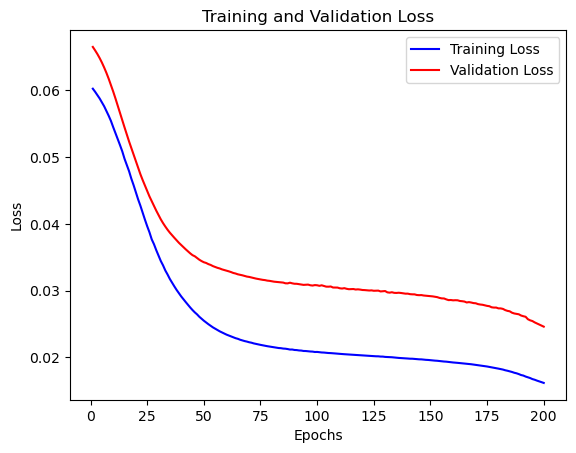

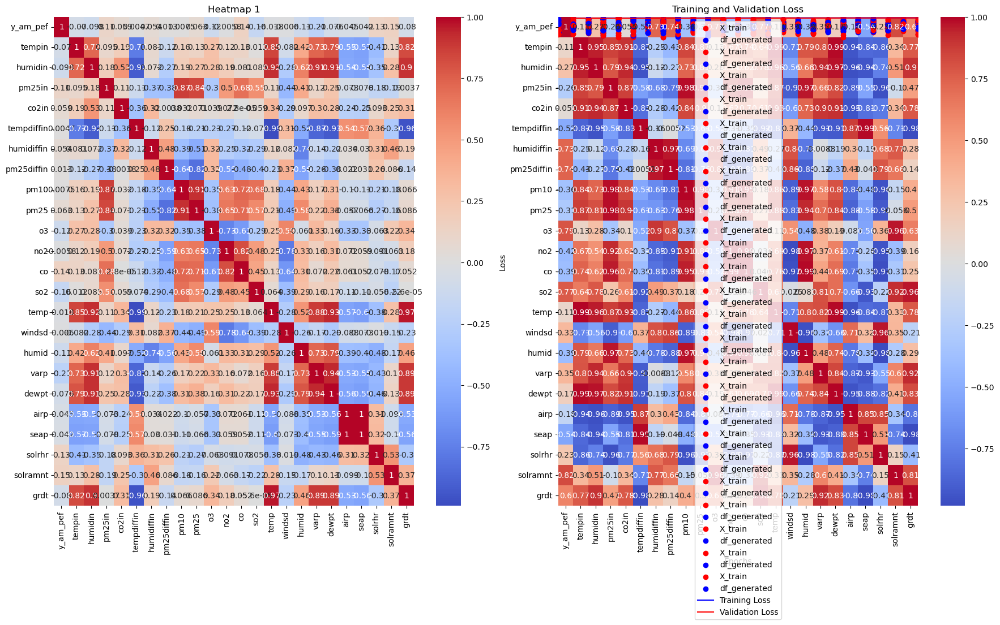

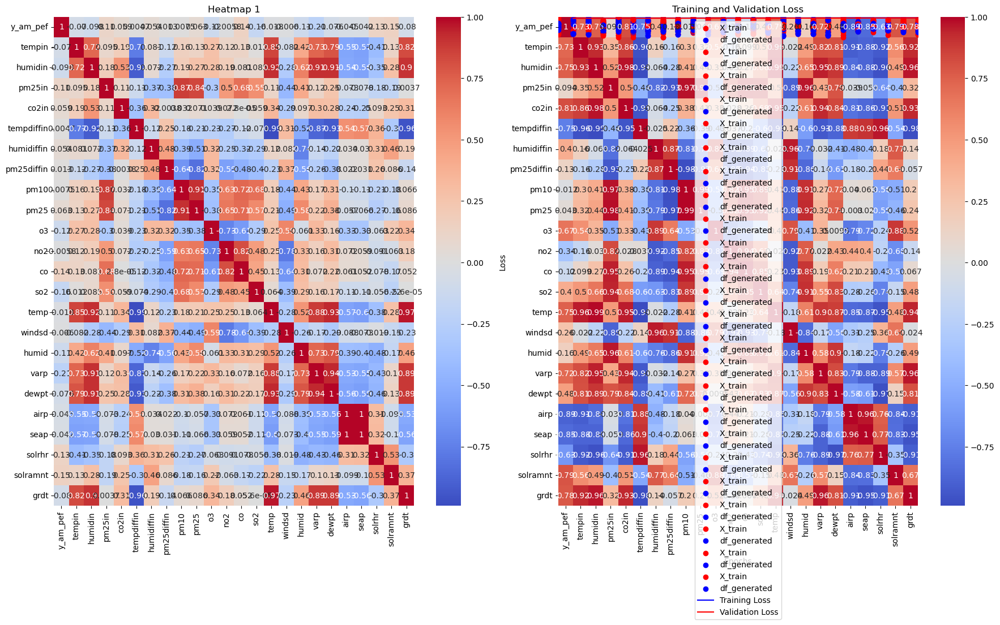

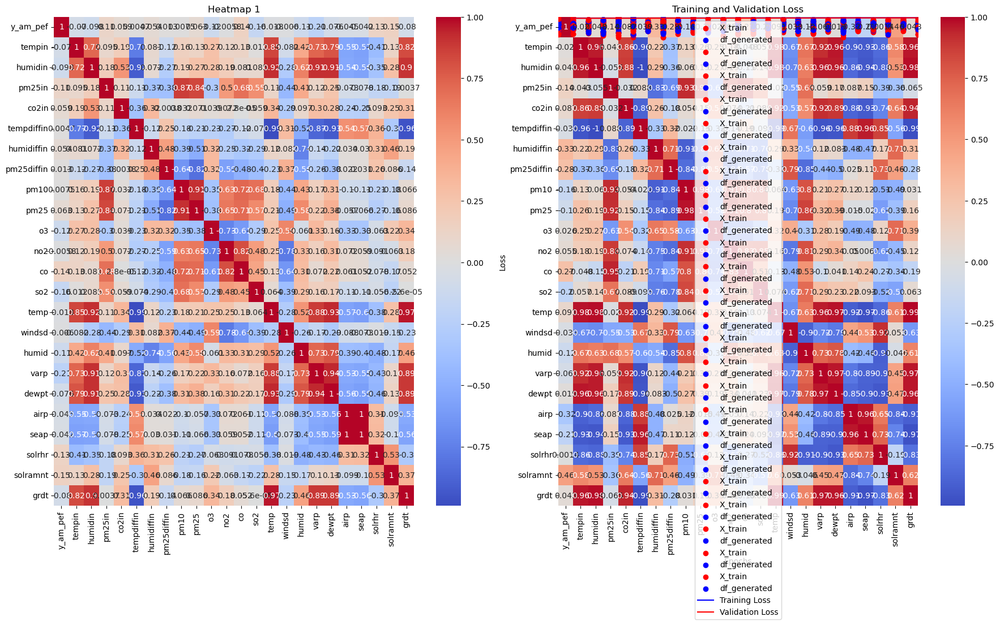

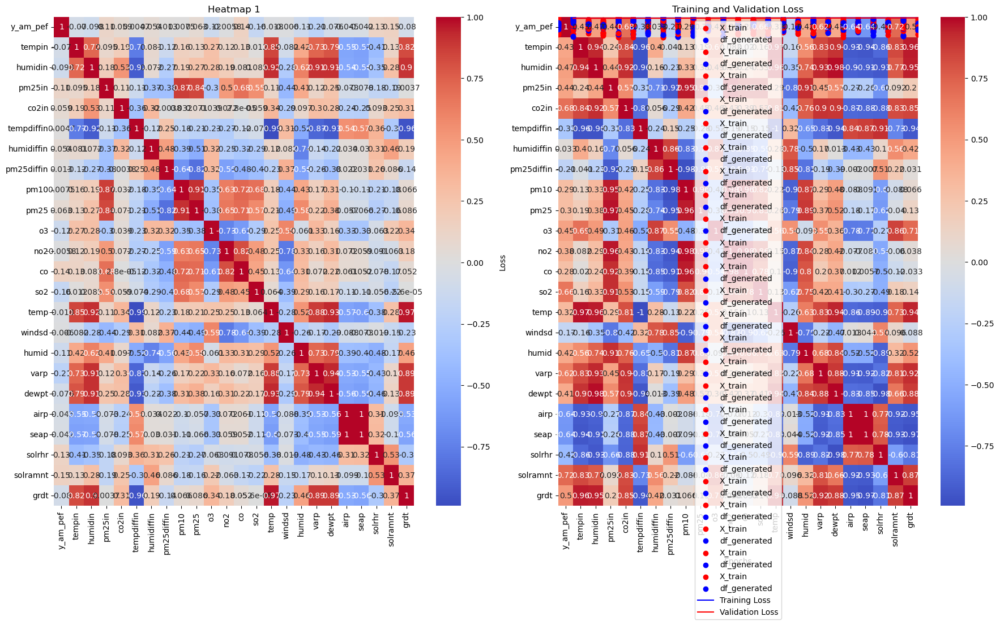

...

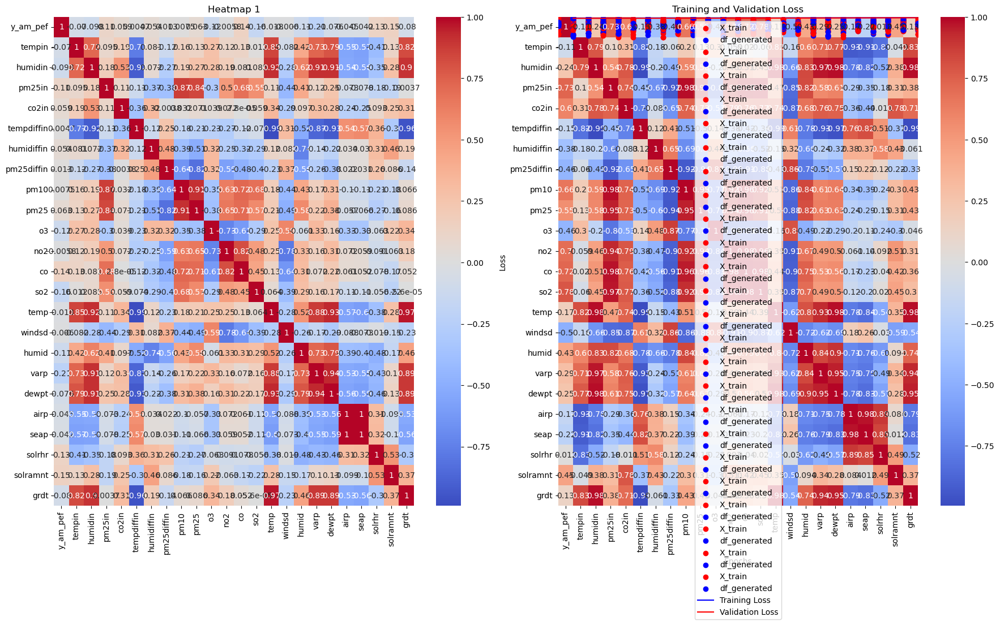

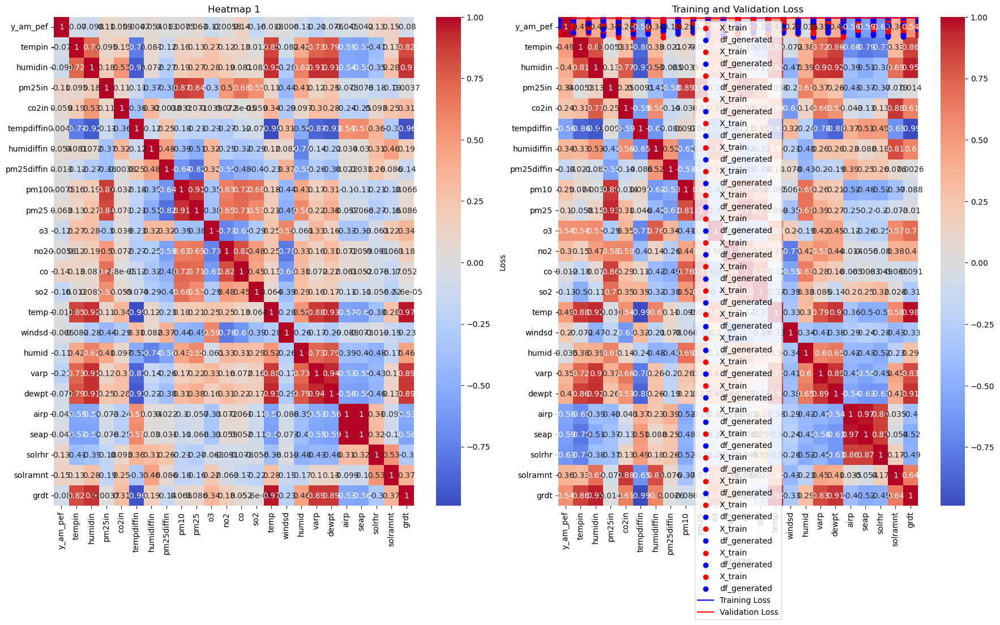

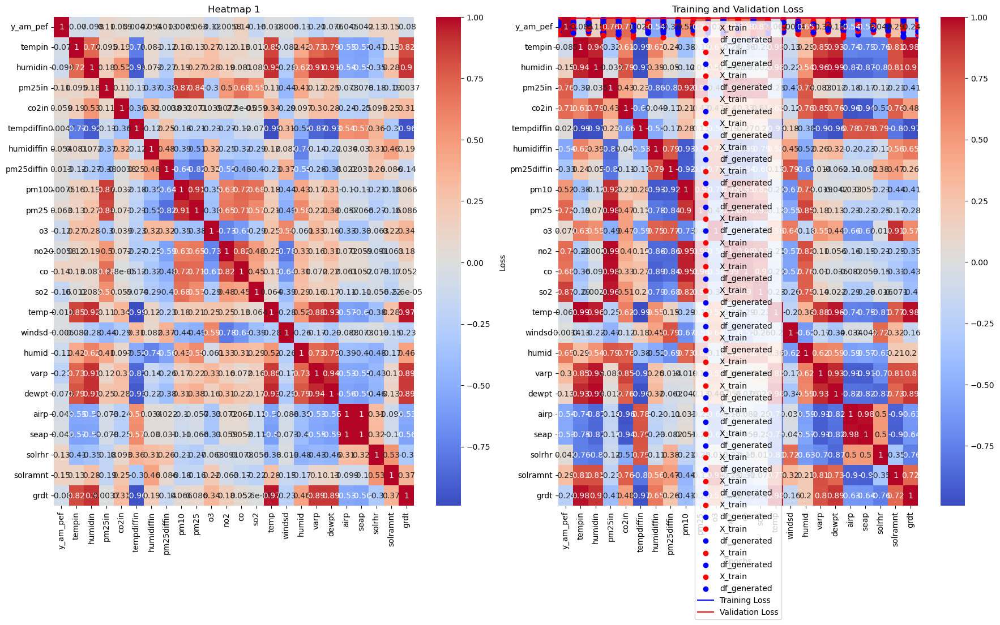

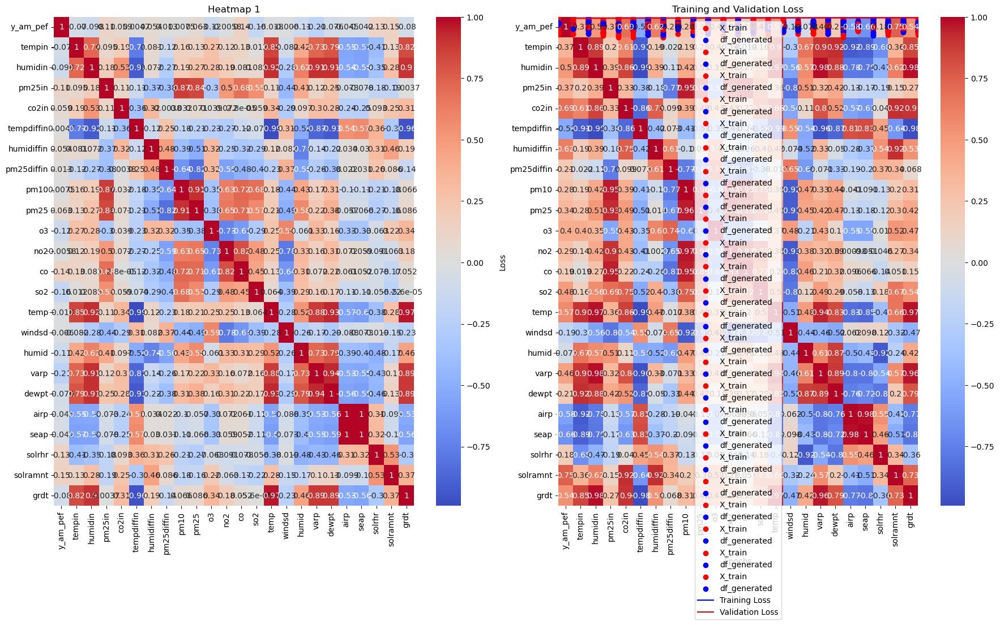

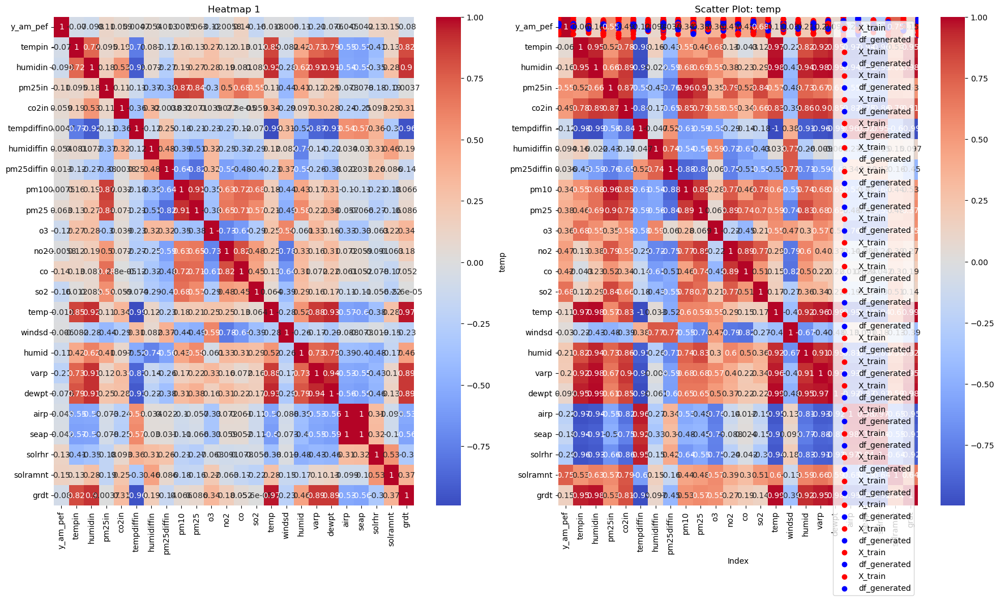

In [11]:
start_time = time.time()

for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)
          runner(enc_layers, bn, dec_layers)
                
end_time = time.time()
total_time = end_time - start_time                
total_time_minutes = total_time / 60
print(f"Total time: {total_time_minutes} minutes") 

In [12]:
import csv
#save run_summary as a file
filename = 'run_summary.csv'

with open(filename, 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(run_summary)

print(f"Run summary has saved: {filename}")

Run summary has saved: run_summary.csv


In [13]:
run_summary.sort(key=lambda x: x[1], reverse=True)  # Sort by the middle value in descending order

top_10 = run_summary[:10]  # Get the top 10 elements

for item in top_10:
    print(item)

['L24_E12_10_B10_D6_8_10_12', 0.020811589434742928, 0.03013676404953003]
['L24_E16_14_B10_D6_8_10_12', 0.01993395946919918, 0.02918754331767559]
['L24_E12_10_B10_D18_20_22_24', 0.01757943443953991, 0.026171820238232613]
['L24_E20_18_B10_D8_10_12_14', 0.016905304044485092, 0.02367393486201763]
['L24_E12_10_B10_D12_14_16_18', 0.016870109364390373, 0.02734498307108879]
['L24_E18_16_B10_D10_12_14_16', 0.01648060791194439, 0.024379078298807144]
['L24_E10_8_B10_D6_8_10_12', 0.01617749035358429, 0.02461046352982521]
['L24_E14_12_B10_D12_14_16_18', 0.015587793663144112, 0.022968223318457603]
['L24_E14_12_B10_D6_8_10_12', 0.014620586298406124, 0.021581241860985756]
['L24_E10_8_B10_D14_16_18_20', 0.014547646045684814, 0.033157821744680405]


In [14]:
for item in run_summary:
    print(item)

['L24_E12_10_B10_D6_8_10_12', 0.020811589434742928, 0.03013676404953003]
['L24_E16_14_B10_D6_8_10_12', 0.01993395946919918, 0.02918754331767559]
['L24_E12_10_B10_D18_20_22_24', 0.01757943443953991, 0.026171820238232613]
['L24_E20_18_B10_D8_10_12_14', 0.016905304044485092, 0.02367393486201763]
['L24_E12_10_B10_D12_14_16_18', 0.016870109364390373, 0.02734498307108879]
['L24_E18_16_B10_D10_12_14_16', 0.01648060791194439, 0.024379078298807144]
['L24_E10_8_B10_D6_8_10_12', 0.01617749035358429, 0.02461046352982521]
['L24_E14_12_B10_D12_14_16_18', 0.015587793663144112, 0.022968223318457603]
['L24_E14_12_B10_D6_8_10_12', 0.014620586298406124, 0.021581241860985756]
['L24_E10_8_B10_D14_16_18_20', 0.014547646045684814, 0.033157821744680405]
['L24_E22_20_B10_D6_8_10_12', 0.014513288624584675, 0.022845793515443802]
['L24_E16_14_B10_D12_14_16_18', 0.014076923951506615, 0.024699261412024498]
['L24_E20_18_B10_D6_8_10_12', 0.013624101877212524, 0.02166975662112236]
['L24_E18_16_B10_D6_8_10_12', 0.01340